In [15]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [ ]:
import pandas as pd 
import numpy as np 
from scipy.stats import linregress
import matplotlib
import matplotlib.pyplot as plt 
import seaborn as sns

import sys 
import os

script_dir = os.path.abspath(os.path.join(os.getcwd(), '../scripts/'))
sys.path.append(script_dir)
from malts_tract_level import malts_tract_level

years = [2012, 2017, 2022]
periods = ['S1', 'S2', 'S3']
period_labels = dict(zip(years, periods))
colors = {
    'S1': 'green', 
    'S2': 'blue', 
    'S3': 'purple'}

font = {'family': 'serif',
         'size': 32,
         'serif':  'cmr10'
         }

matplotlib.rc('font', **font)
plt.rcParams['axes.unicode_minus'] = False

In [17]:
### Function to run MALTS pipeline

STRUCTURES = ['abandoned_buildings', 'rail_stations', 'bus_stops', 'public_schools', 'libraries', 'restaurants', 'grocery_stores']

def calculate(structure_name, years, outcome = 'real'): 
    for year in years: 
        mt = malts_tract_level(city = 'chi', structure = structure_name, year = year, outcome = outcome)
        mt.set_treatment(quantile_cut = 0.1)
        mt.fit_malts(
            n_splits = 5,
            n_repeats = 2,
            match_threshold = 2)
        mt.CATE()
        mt.save_tables('tables/')
        print(f'{structure_name} {year}')

In [21]:
### Variance calculation 

def variance(df, outcome = 'real'):

  if outcome == 'real': 
    outcome_col = 'crime_rate'
  else:
    outcome_col = 'perceived_crime'

  n = df.shape[0]
  tvar = df['var_malts'].sum()
  
  M = np.asarray(df[df['tract_id']])
  M = np.where(M >= 2, 1, 0) # 2 comes from match threshold, change as needed

  treat = np.asarray(df['treatment'])
  mg_treated = M.dot(treat) # number treated units in mg
  mg_control = M.dot(1 - treat) # number control units in mg
  M_T = M*treat
  inter_treated = np.matmul(M_T, M_T.T) # number of shared treated units between every pair of match groups 
  M_C = M*(1 - treat)
  inter_control = np.matmul(M_C, M_C.T) # number of shared control units between every pair of match groups 
  inv_t = np.outer(1.0 / mg_treated, 1.0 / mg_treated)
  inv_c = np.outer(1.0 / mg_control, 1.0 / mg_control)
  # weight_i,j = |mg_i,t inter mg_j,t|/|mg_i,t||mg_j,t| + |mg_i,c inter mg_j,c|/|mg_i,c||mg_j,c|
  weight = np.matmul(inter_treated, inv_t) + np.matmul(inter_control, inv_c)
  np.fill_diagonal(weight, 0) # i != j
  weight *= df[outcome_col].var() # sum_{i != j} Cov(T_i, T_j) = sum_{i != j} s*weight_i,j
  
  return (weight.sum().sum() + tvar) / n**2

In [22]:
### Violin plot code

def violin_plot(structure_name, years, prune = True):

    df_combined = pd.DataFrame()
    ates, sems = [], []
    for year in years: 
        df = pd.read_csv(f'tables/chi_{structure_name}_{year}_crime_rate.csv')
        if prune: 
            max_diameter = df['diameter'].mean() + 2*df['diameter'].std()
            df = df.drop(df[df['diameter'] > max_diameter].index)

        ate = df['CATE'].mean()
        ates.append(ate)
        var = variance(df.copy(deep = True))
        n = df.shape[0]
        sems.append(np.sqrt(var) / n)
        df['year'] = period_labels[year]
        df_combined = pd.concat([df_combined, df], axis = 0)

    fig, ax = plt.subplots(figsize = (12, 4))
    sns.violinplot(
        df_combined, 
        x = 'year', 
        y = 'CATE', 
        hue = 'year', 
        palette = colors, 
        linewidth = 0.5,
        orient = 'v', 
        inner = None,
        )
    for violin in ax.collections[::]:
        violin.set_alpha(0.5)
    # inner_kws = {'box_width': 8, 'whis_width': 1, 'color': 'black'}
    ax.axhline(
        y = 0, 
        color = 'black', 
        linewidth = 1)
    ax.errorbar(
        x = np.asarray(periods, dtype = str), 
        y = np.asarray(ates), 
        yerr = np.asarray(sems), 
        color = 'black',
        fmt = 'o', 
        capsize = 6)
    
    title = ' '.join(structure_name.split('_')).title()
    fig.suptitle(f'Chicago {title}')
    ax.spines[['right', 'top', 'bottom']].set_visible(False)
    ax.set_xlabel('')
    ax.tick_params(axis = 'x', which = 'both', length = 0)
    ax.set_ylabel('CATE')
    ax.set_yticks([0, 0.05])
    ax.set_yticklabels([0, 0.05])

    return fig 

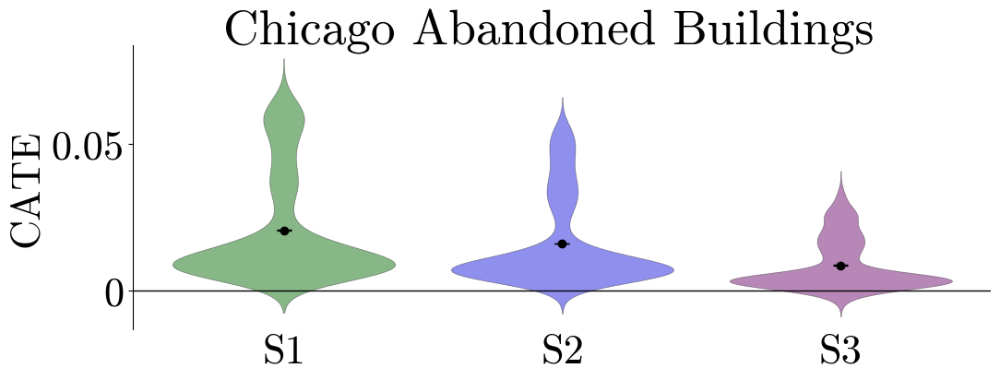

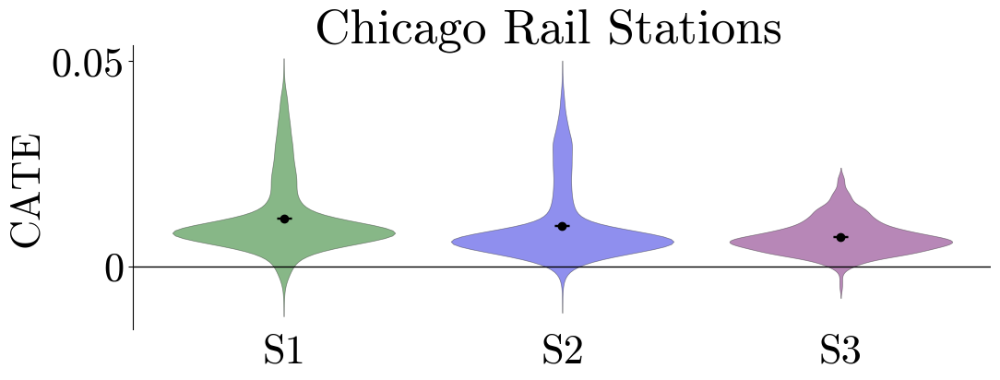

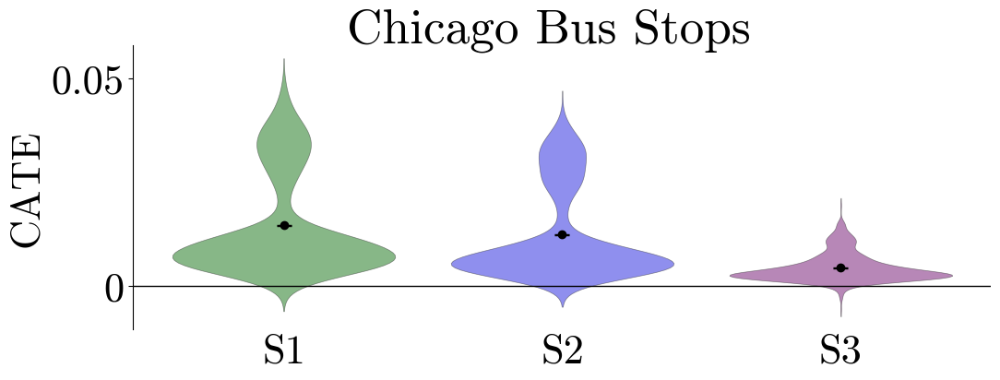

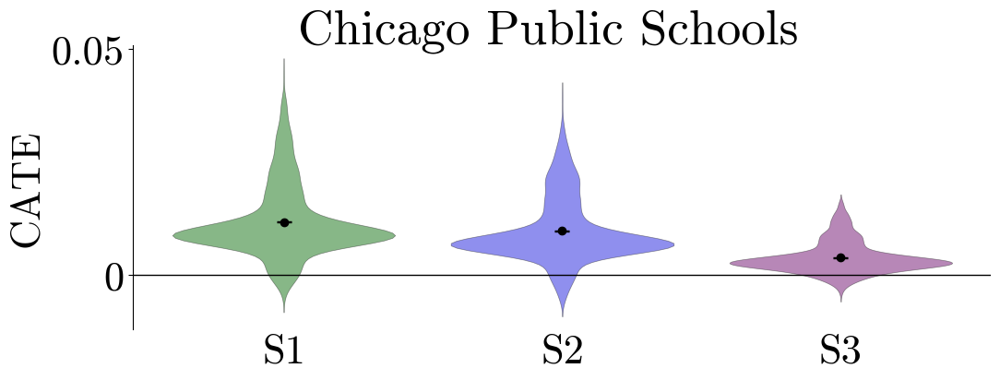

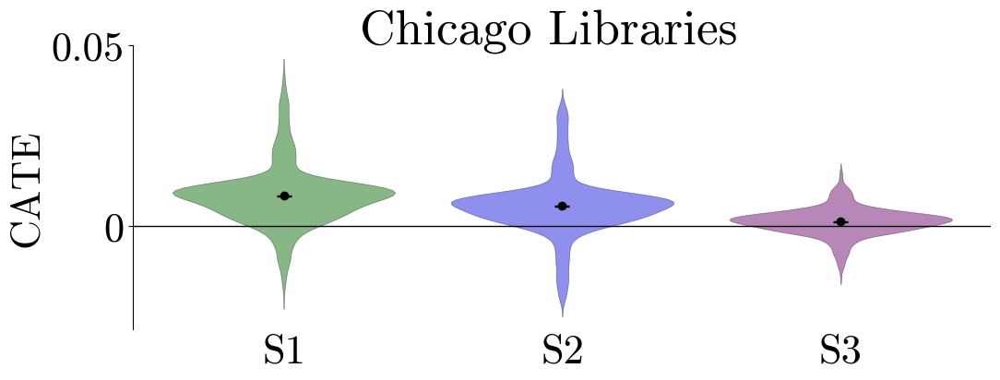

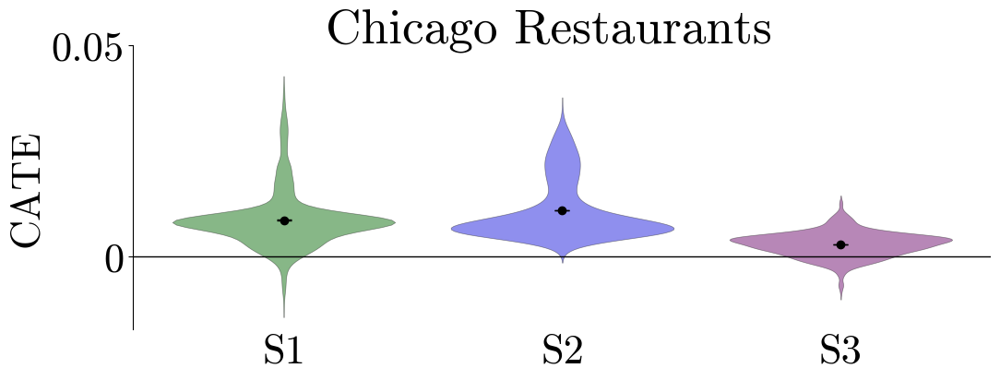

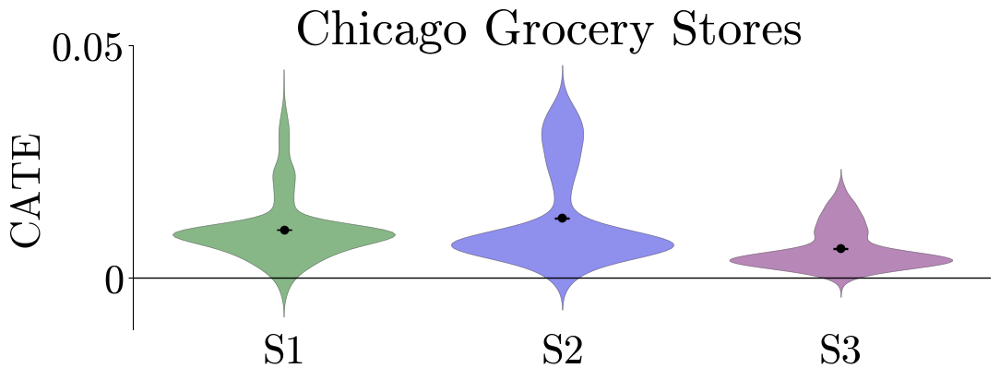

In [23]:
### Generate violin plots for actual crime

for structure in STRUCTURES: 
    violin_plot(structure, [2012, 2017, 2022]).savefig(f'figures/mtl_chicago_{structure}.png', bbox_inches = 'tight')

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


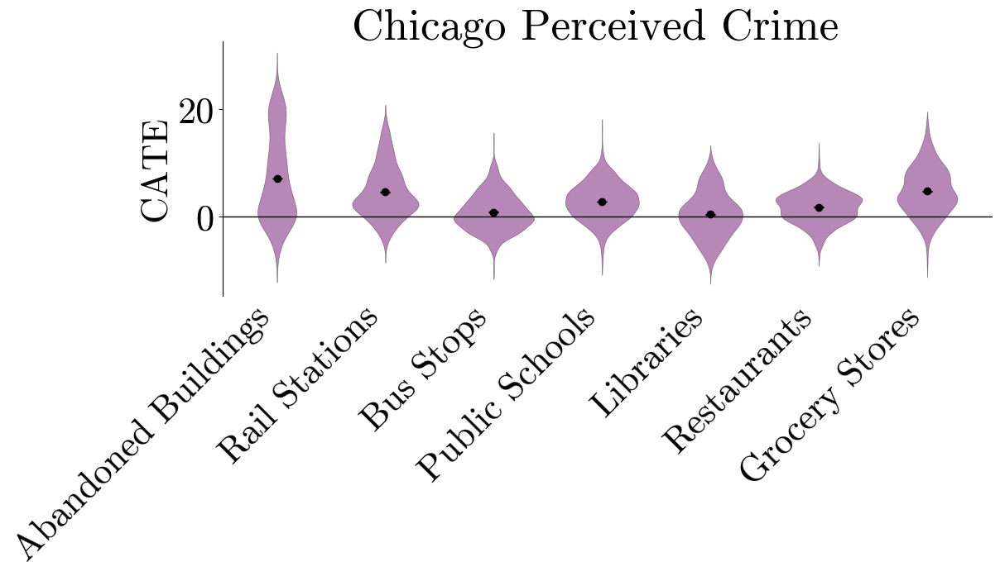

In [24]:
### Generate violin plots for perceived crime

df_combined = pd.DataFrame()
ates, sems = [], []
for structure in STRUCTURES: 
    df = pd.read_csv(f'tables/chi_{structure}_2022_perceived_crime.csv')
    # comment to turn pruning off
    max_diameter = df['diameter'].mean() + 2*df['diameter'].std()
    df = df.drop(df[df['diameter'] > max_diameter].index)

    ate = df['CATE'].mean()
    ates.append(ate)
    var = variance(df.copy(deep = True), outcome = 'perceived')
    n = df.shape[0]
    sems.append(np.sqrt(var) / n)
    df['structure'] = ' '.join(structure.split('_')).title()
    df_combined = pd.concat([df_combined, df], axis = 0)

fig, ax = plt.subplots(figsize = (12, 4))
sns.violinplot(
    df_combined, 
    x = 'structure', 
    y = 'CATE', 
    color = 'purple',
    linewidth = 0.5,
    orient = 'v', 
    inner = None,
    )
for violin in ax.collections[::]:
    violin.set_alpha(0.5)
# inner_kws = {'box_width': 8, 'whis_width': 1, 'color': 'black'}
ax.axhline(
    y = 0, 
    color = 'black', 
    linewidth = 1)
ax.errorbar(
    x = np.asarray(df_combined['structure'].unique(), dtype = str), 
    y = np.asarray(ates), 
    yerr = np.asarray(sems), 
    color = 'black',
    fmt = 'o', 
    capsize = 4)

fig.suptitle(f'Chicago Perceived Crime')
ax.set_xlabel('')
ax.set_xticklabels(df_combined['structure'].unique(), ha = 'right')
ax.tick_params(axis = 'x', which = 'both', length = 0, rotation = 45)
ax.set_ylabel('CATE')
ax.legend().set_visible(False)
ax.spines[['right', 'top', 'bottom']].set_visible(False)

fig.savefig('figures/mtl_chicago_perceived_crime.png', bbox_inches='tight')

In [25]:
### Heatmap code

def heatmap(structure_name, years):

    fig, axs = plt.subplots(1, 3, figsize = (12, 4))
    title = ' '.join(structure_name.split('_')).title()
    fig.suptitle(f'Chicago {title} (Actual Crime)', y = 1.05)
    
    for i, year in enumerate(years): 
        df = pd.read_csv(f'tables/chi_{structure_name}_{year}_crime_rate.csv')

        hm = sns.heatmap(
            data = df[df['tract_id']], 
            ax = axs[i], 
            cbar = False)
        axs[i].set_xticks([])
        axs[i].set_xlabel(period_labels[year])
        axs[i].set_yticks([])

    cb = fig.colorbar(
        hm.collections[0],
        ax = axs.ravel().tolist(),
        orientation = "horizontal",
        fraction = 0.05,
        pad = 0.2)
    cb.set_ticks([0, 4, 8])
    cb.set_ticklabels([0, 4, 8])

    return fig

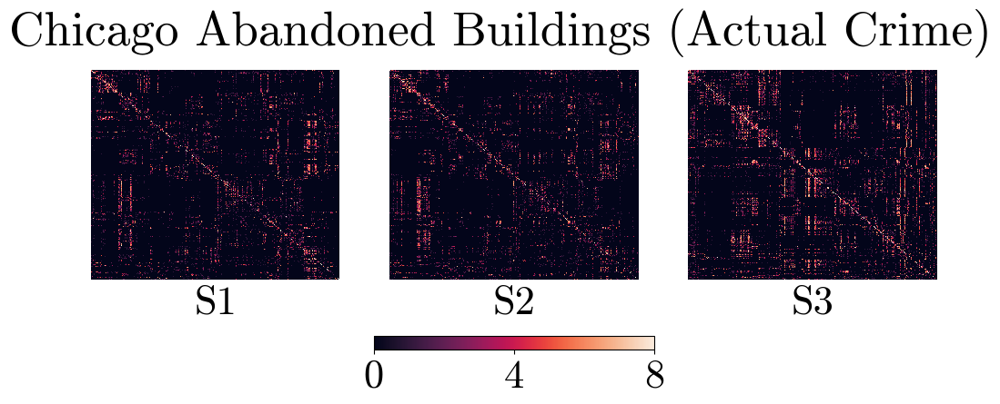

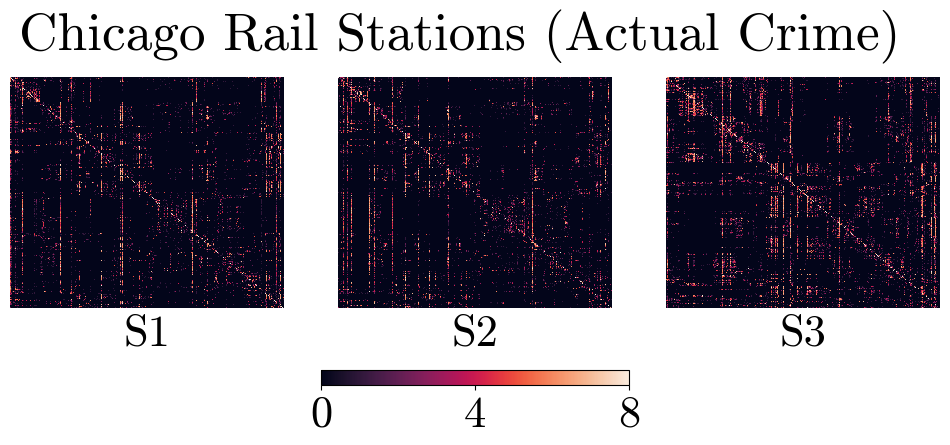

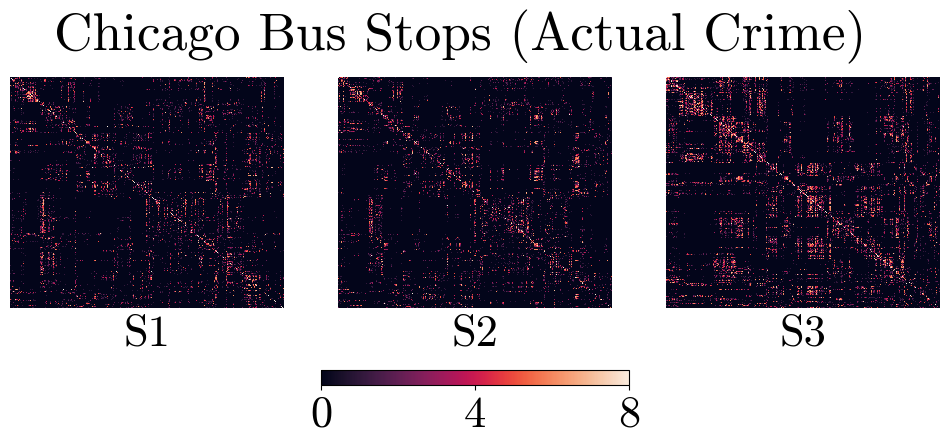

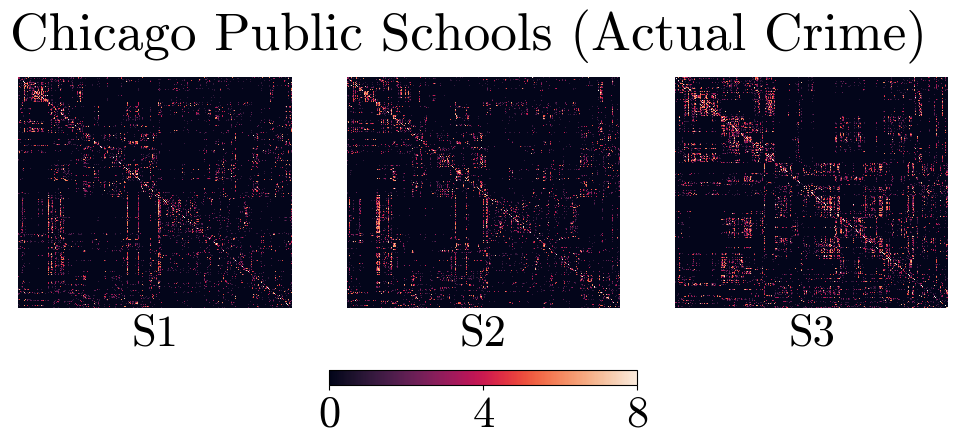

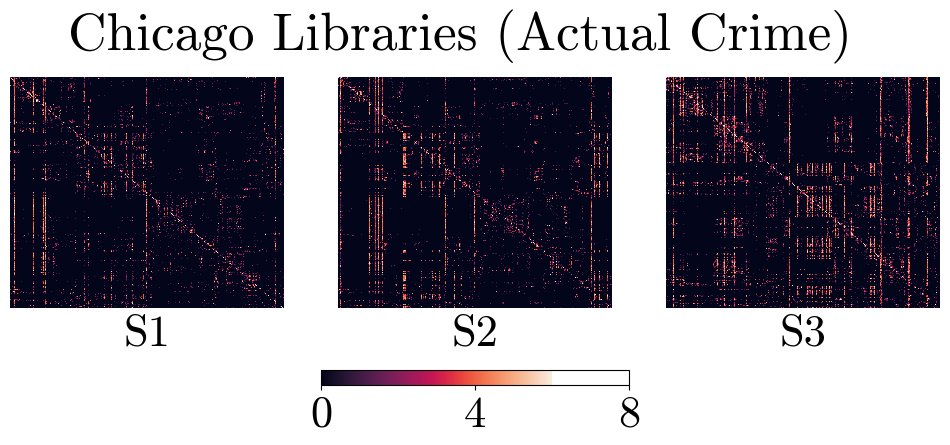

...

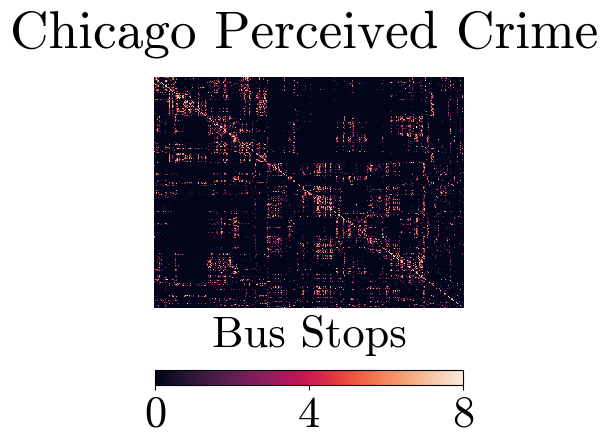

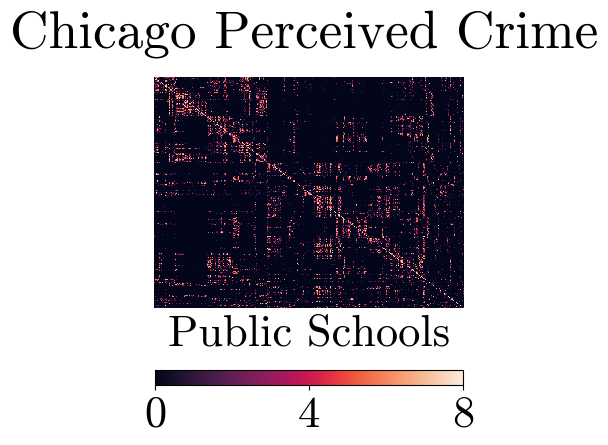

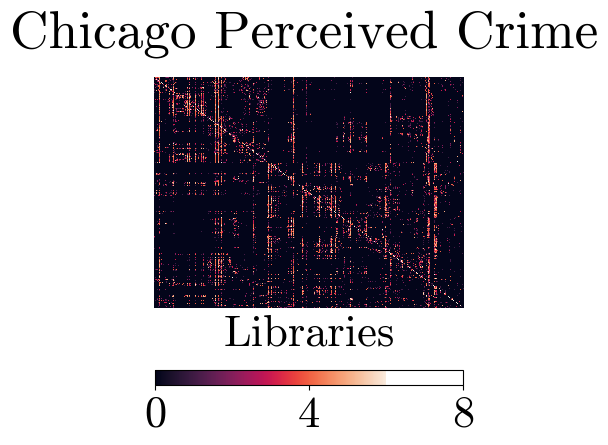

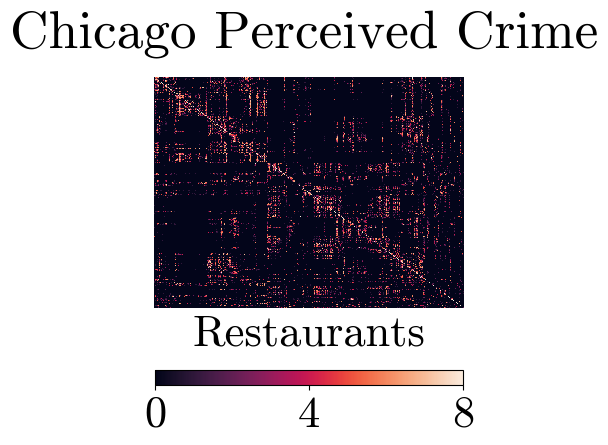

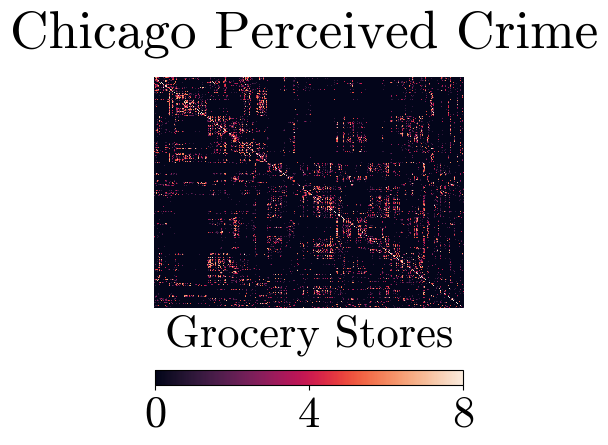

In [26]:
### Generate heatmaps

# Actual crime

for structure in STRUCTURES: 
    heatmap(structure, [2012, 2017, 2022]).savefig(f'figures/heatmaps/mtl_chicago_{structure}_heatmap_actual_crime.png', bbox_inches='tight')

# Perceived crime (2022 only)
for structure in STRUCTURES: 
    df = pd.read_csv(f'tables/chi_{structure}_2022_perceived_crime.csv')

    fig, ax = plt.subplots(figsize = (4, 4))
    title = ' '.join(structure.split('_')).title()
    fig.suptitle(f'Chicago Perceived Crime', y = 1.05)
    hm = sns.heatmap(
        data = df[df['tract_id']], 
        ax = ax, 
        cbar = False)
    ax.set_xticks([])
    ax.set_xlabel(title)
    ax.set_yticks([])

    cb = fig.colorbar(
        hm.collections[0],
        ax = ax,
        orientation = "horizontal",
        fraction = 0.05,
        pad = 0.2)
    cb.set_ticks([0, 4, 8])
    cb.set_ticklabels([0, 4, 8])

    fig.savefig(f'figures/heatmaps/mtl_chicago_{structure}_heatmap_perceived_crime.png', bbox_inches='tight')

In [27]:
### Covariate vs. CATE scatter plot code

COVARIATES = ['total_pop', 'male_pop', 'female_pop', 'pop_density', 'num_households', 
              'white_pop', 'black_pop', 'nat_pop', 'asian_pop', 'mixed_pop', 'other_pop', 
              'no_highschool', 'highschool', 'undergrad', 'postgrad', 
              'in_labor', 'unemployed', 'median_income', 'poverty', 
              'male_never_married', 'male_married', 'male_divorced', 'female_never_married', 'female_married', 'female_divorced', 
              'm_juv', 'm_ad', 'm_eld', 'f_juv', 'f_ad', 'f_eld'] 

def covariate_cate_scatter(structure_name, covariate, years, prune = True):

    fig, axs = plt.subplots(1, 3, constrained_layout = True, figsize = (12, 4))
    title = ' '.join(structure_name.split('_')).title()
    fig.suptitle(f'Chicago {title}', y = 1.2)

    significant = False

    for i, year in enumerate(years): 
        df = pd.read_csv(f'tables/chi_{structure_name}_{year}_crime_rate.csv')
        if prune: 
            max_diameter = df['diameter'].mean() + 2*df['diameter'].std()
            df = df.drop(df[df['diameter'] > max_diameter].index)

        covariate_str = ' '.join(covariate.split('_'))
        if covariate[:4] == 'male': 
            covariate_str = 'm ' + covariate_str.removeprefix('male ')
        if covariate[:6] == 'female':
            covariate_str = 'f ' + covariate_str.removeprefix('female ')
        xlim, xticks = [-0.1, 1.1], [0, 0.5, 1]
        axs[i].set_xlim(xlim)
        axs[i].set_xticks(xticks)
        axs[i].set_xticklabels(xticks)
        ylim, yticks = [-0.005, 0.09], [0, 0.05]
        axs[i].set_ylim(ylim)
        axs[i].set_yticks(yticks)
        axs[i].set_yticklabels(yticks)
        
        axs[i].scatter(
            x = df[covariate],
            y = df['CATE'],
            s = 5,
            c = colors[period_labels[year]],
            alpha = 0.15
        )

        reg = linregress(df[covariate], df['CATE'])
        m, b, r2 = reg.slope, reg.intercept, reg.rvalue**2
        axs[i].plot(
            np.asarray(xlim),
            m*np.asarray(xlim) + b,
            c = colors[period_labels[year]],
            linestyle = '--',
            label = fr'$r^2 = {round(r2, 2)}$'
        )

        if r2 >= 0.5: 
            significant = True
            axs[i].set_title(period_labels[year] + '*')
        else:
            axs[i].set_title(period_labels[year])

        axs[i].legend(
            handlelength = 0,
            fontsize = 'xx-small',
            loc = 'upper left')

    axs[1].set_xlabel(covariate_str)
    axs[0].set_ylabel('CATE')

    return fig, significant

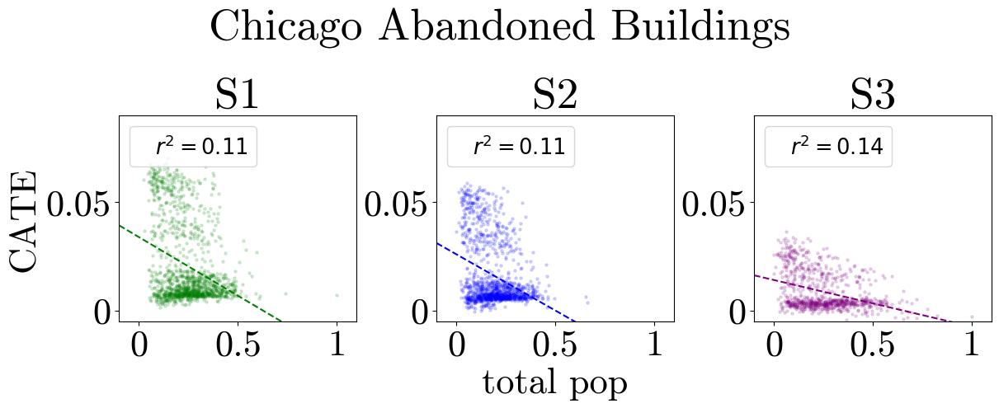

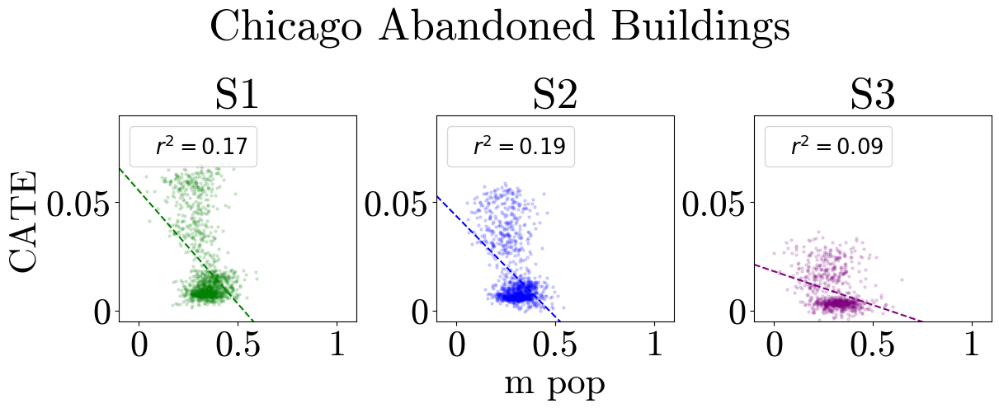

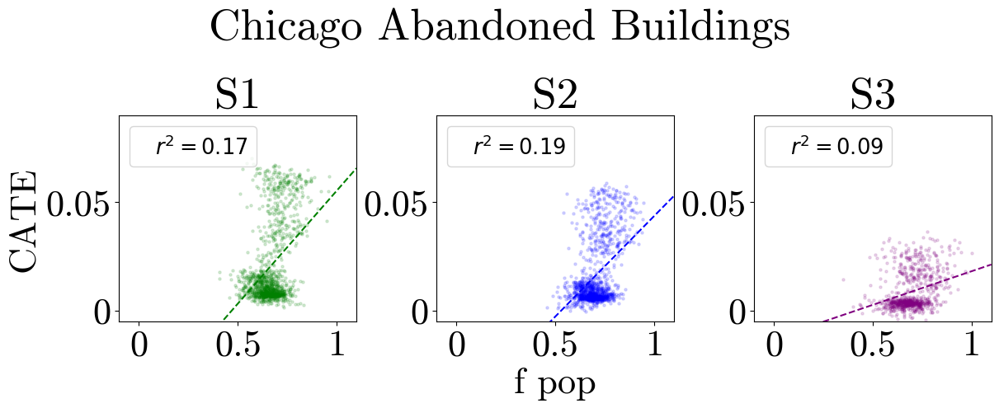

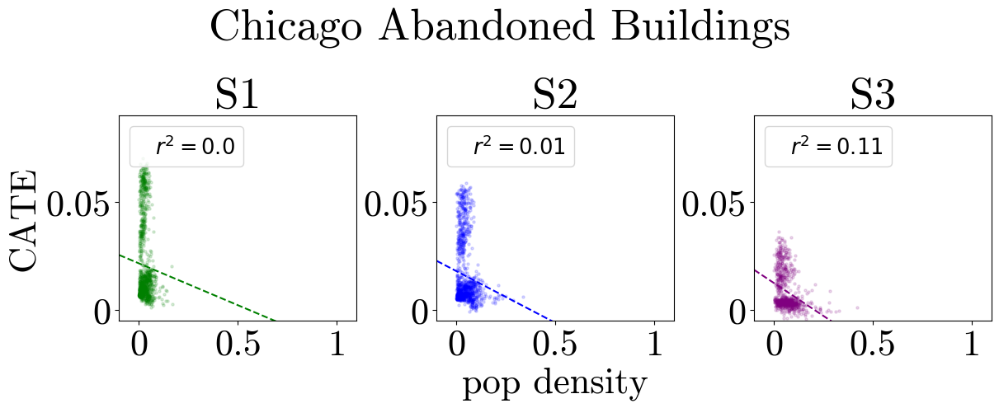

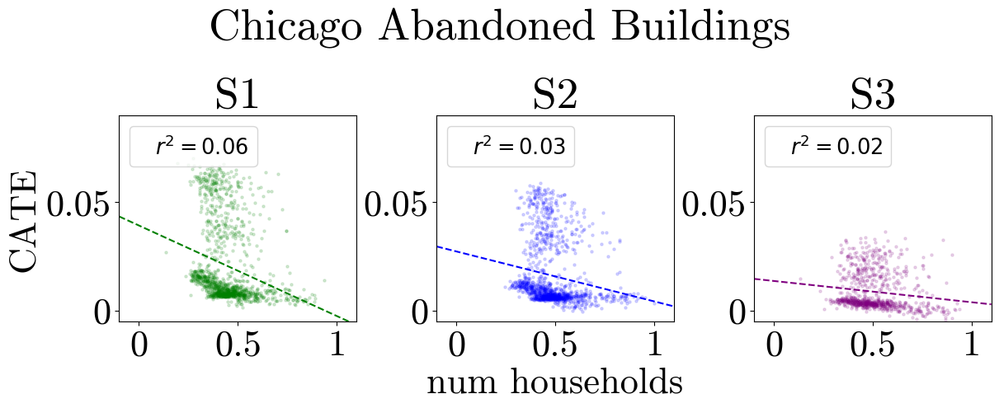

...

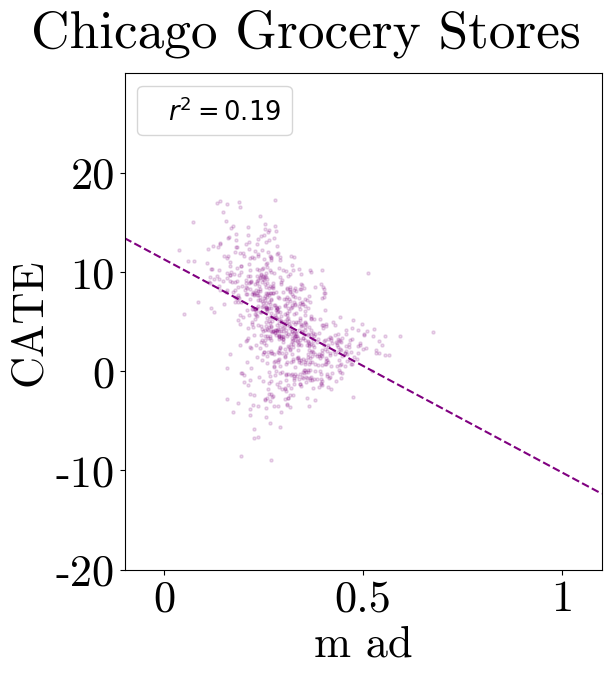

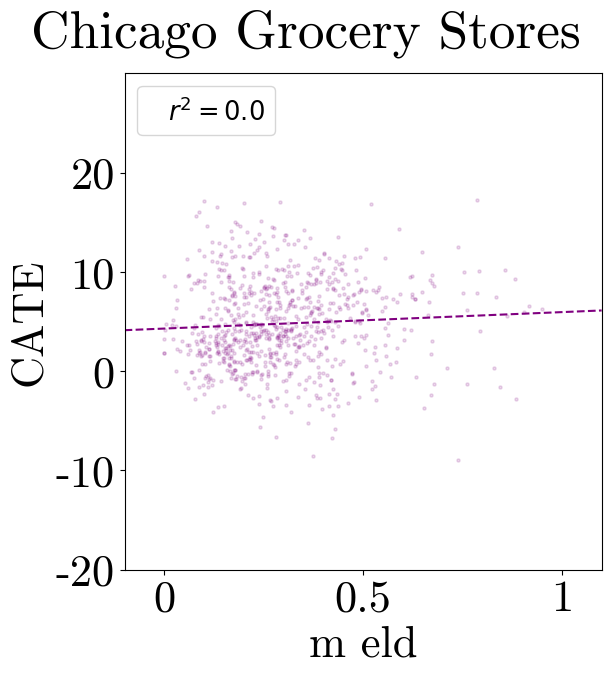

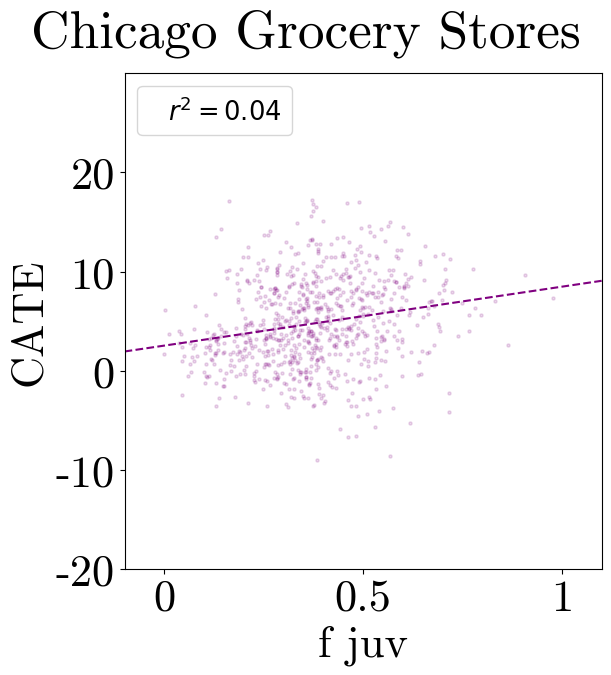

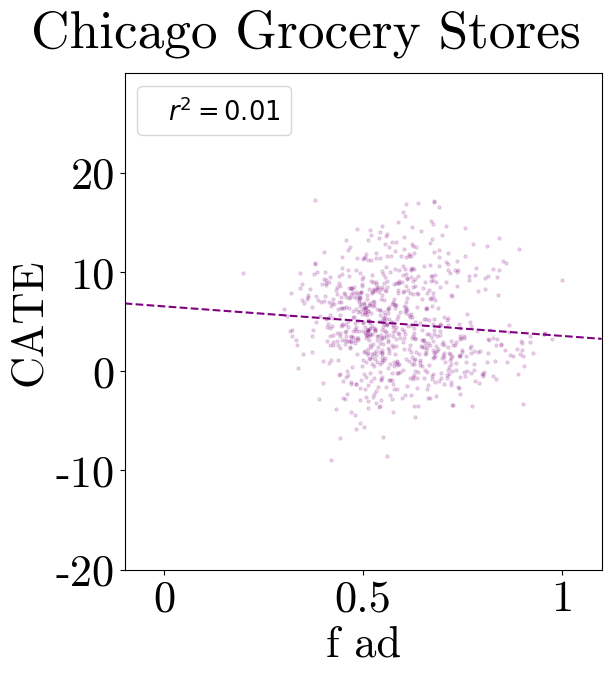

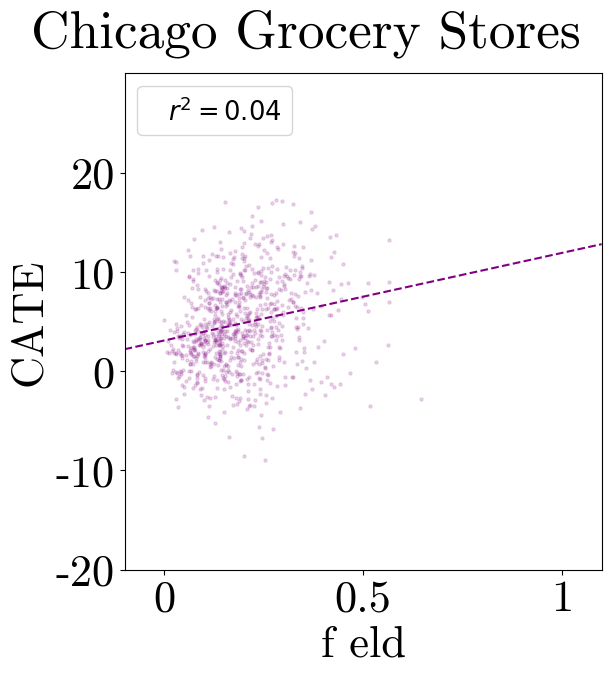

In [28]:
### Generate covariate vs. CATE plots

# Actual crime

for structure in STRUCTURES: 
    for covariate in COVARIATES:
        f, s = covariate_cate_scatter(structure, covariate = covariate, years = [2012, 2017, 2022])
        fpath = 'figures/cate_covariate_plots/'
        if s: 
            f.savefig(fpath + f'significant/mtl_chicago_{structure}_{covariate}_scatter_actual_crime.png', bbox_inches='tight')
        else:
            f.savefig(fpath + f'mtl_chicago_{structure}_{covariate}_scatter_actual_crime.png', bbox_inches='tight')

# Perceived crime (2022 only)

for structure in STRUCTURES: 
    for covariate in COVARIATES:

        significant = False
        
        fig, ax = plt.subplots(constrained_layout = True, figsize = (6, 6))
        title = ' '.join(structure.split('_')).title()

        df = pd.read_csv(f'tables/chi_{structure}_2022_perceived_crime.csv')
        # comment to turn pruning off
        max_diameter = df['diameter'].mean() + 2*df['diameter'].std()
        df = df.drop(df[df['diameter'] > max_diameter].index)

        covariate_str = ' '.join(covariate.split('_'))
        if covariate[:4] == 'male': 
            covariate_str = 'm ' + covariate_str.removeprefix('male ')
        if covariate[:6] == 'female':
            covariate_str = 'f ' + covariate_str.removeprefix('female ')
        xlim, xticks = [-0.1, 1.1], [0, 0.5, 1]
        ax.set_xlim(xlim)
        ax.set_xticks(xticks)
        ax.set_xticklabels(xticks)
        ylim, yticks = [-20, 30], [-20, -10, 0, 10, 20]
        ax.set_ylim(ylim)
        ax.set_yticks(yticks)
        ax.set_yticklabels(yticks)
        ax.set_xlabel(covariate_str)
        ax.set_ylabel('CATE')

        ax.scatter(
            x = df[covariate],
            y = df['CATE'],
            s = 5,
            c = 'purple',
            alpha = 0.15
        )

        reg = linregress(df[covariate], df['CATE'])
        m, b, r2, p = reg.slope, reg.intercept, reg.rvalue**2, reg.pvalue
        ax.plot(
            np.asarray(xlim),
            m*np.asarray(xlim) + b,
            c = 'purple',
            linestyle = '--',
            label = fr'$r^2 = {round(r2, 2)}$'
        )

        if r2 >= 0.5: 
            significant = True
            plt.suptitle(f'Chicago {title}*', y = 1.1)
        else:
            plt.suptitle(f'Chicago {title}', y = 1.1)

        ax.legend(
            handlelength = 0,
            fontsize = 'xx-small',
            loc = 'upper left')
        
        if significant: 
            fig.savefig(f'figures/cate_covariate_plots/significant/mtl_chicago_{structure}_{covariate}_scatter_perceived_crime.png', bbox_inches='tight')
        else:
            fig.savefig(f'figures/cate_covariate_plots/mtl_chicago_{structure}_{covariate}_scatter_perceived_crime.png', bbox_inches='tight')

In [29]:
### Perceived and Actual Crime Treatment Rankings 

ates, sems = [], []
for structure in STRUCTURES: 
    df = pd.read_csv(f'tables/chi_{structure}_2022_crime_rate.csv')
    # comment to turn pruning off
    max_diameter = df['diameter'].mean() + 2*df['diameter'].std()
    df = df.drop(df[df['diameter'] > max_diameter].index)

    ate = df['CATE'].mean()
    ates.append(ate)
    var = variance(df.copy(deep = True))
    n = df.shape[0]
    sems.append(np.sqrt(var) / n)
actual_crime = pd.DataFrame(
    index = STRUCTURES,
    columns = ['ate', 'sem']
)
actual_crime['ate'] = ates 
actual_crime['sem'] = sems 

ates, sems = [], []
for structure in STRUCTURES: 
    df = pd.read_csv(f'tables/chi_{structure}_2022_perceived_crime.csv')
    # comment to turn pruning off
    max_diameter = df['diameter'].mean() + 2*df['diameter'].std()
    df = df.drop(df[df['diameter'] > max_diameter].index)

    ate = df['CATE'].mean()
    ates.append(ate)
    var = variance(df.copy(deep = True), outcome = 'perceived')
    n = df.shape[0]
    sems.append(np.sqrt(var) / n)
perceived_crime = pd.DataFrame(
    index = STRUCTURES,
    columns = ['ate', 'sem']
)
perceived_crime['ate'] = ates 
perceived_crime['sem'] = sems 

In [30]:
actual_crime.sort_values(by = 'ate', ascending = False)

,ate,sem
abandoned_buildings,0.008566,0.000060
rail_stations,0.007177,0.000081
grocery_stores,0.006322,0.000055
bus_stops,0.004290,0.000056
public_schools,0.003884,0.000055
restaurants,0.002945,0.000057
libraries,0.001301,0.000088


In [31]:
perceived_crime.sort_values(by = 'ate', ascending = False)

,ate,sem
abandoned_buildings,7.116101,0.056576
grocery_stores,4.780385,0.050040
rail_stations,4.585676,0.072728
public_schools,2.827532,0.050082
restaurants,1.771290,0.050693
bus_stops,0.832486,0.050368
libraries,0.440011,0.077275
